In [1]:
! pip install networkx
! pip install plotly
! pip install colorlover
! pip install stop-words
import nltk
nltk.download('stopwords') 
import networkx as nx
import pandas as pd
from collections import Counter
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import *
import plotly.graph_objects as go
import random
import colorlover as cl
from IPython.display import HTML
import plotly
import matplotlib.pyplot as plt
import seaborn as sns
from nltk.tokenize import RegexpTokenizer
from nltk.corpus import stopwords
from stop_words import get_stop_words
import re
from sklearn.preprocessing import MinMaxScaler
init_notebook_mode(connected=True)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [0]:
df = pd.read_csv("tweets2009-06-0115.csv.zip", sep='\t', compression='zip')

In [0]:
from collections import Counter

In [0]:
allTweets = df["tweet"].str.cat(sep=' ')
tweetWords = [word.strip(""" ,.:'\";""").lower() for word in allTweets.split()]
hashTags = [word for word in tweetWords if word.startswith("#")]
hashTagsCounter = Counter(hashTags)

In [5]:
hashTagsCounter.most_common(100)

[('#iranelection', 26853),
 ('#followfriday', 16400),
 ('#jobs', 13322),
 ('#iremember', 11057),
 ('#spymaster', 10587),
 ('#ff', 10446),
 ('#squarespace', 9198),
 ('#tcot', 7691),
 ('#fb', 6107),
 ('#cnnfail', 4451),
 ('#11thcommandment', 3429),
 ('#jtv', 3317),
 ('#140mafia', 3144),
 ('#iran', 2935),
 ('#', 2895),
 ('#news', 2837),
 ('#quote', 2750),
 ('#vampirebite', 2634),
 ('#1', 2587),
 ('#bsb', 2433),
 ('#tweetmyjobs', 2086),
 ('#iphone', 1697),
 ('#lastfm', 1599),
 ('#mp2', 1589),
 ('#niley', 1528),
 ('#music', 1489),
 ('#p2', 1439),
 ('#follow', 1390),
 ('#pawpawty', 1305),
 ('#hhrs', 1256),
 ('#fail', 1246),
 ('#twitter', 1216),
 ('#tlot', 1214),
 ('#facebook', 1177),
 ('#sgp', 1151),
 ('#mashchat', 1143),
 ('#tinychat', 1111),
 ('#2', 1107),
 ('#digg', 1102),
 ('#gop', 1009),
 ('#phish', 1001),
 ('#mlb', 962),
 ('#travel', 932),
 ('#bonnaroo', 887),
 ('#twitpocalypse', 879),
 ('#iranelections', 857),
 ('#rt', 856),
 ('#zensursula', 811),
 ('#jamlegend', 790),
 ('#quotes', 75

### Q2: Build a Mention Graph

###(a)

In [0]:
cnnTag = df[df["tweet"].str.lower().str.contains("#cnnfail", na=False)].copy()

In [0]:
def addMentionedColumn(df):
    
    def mentionsList(txt):
        allWords = [word.strip(""" ,.:'\";""").lower() for word in txt.split()]
        allNames = [word.strip("@") for word in allWords if word.startswith("@")]
        uniqueNames = list(set(allNames))
        return allNames
    
    df["mentioned"] = df["tweet"].apply(mentionsList)

In [0]:
addMentionedColumn(cnnTag)

In [9]:
cnnTag.head(10)

,date,user,tweet,mentioned
2575522,2009-06-14 02:14:43,sxyblkmn,RT @MattReeves17: Help put pressure on CNN to ...,[mattreeves17]
2575948,2009-06-14 02:15:29,saharou,RT @MattReeves17: Help put pressure on CNN to ...,[mattreeves17]
2576897,2009-06-14 02:16:17,k_may_li,RT: @sxyblkmn: RT @MattReeves17: Help put pres...,"[sxyblkmn, mattreeves17]"
2576927,2009-06-14 02:16:18,spaley,@spaley RT Help put pressure on CNN to cover t...,"[spaley, mattreeves17)]"
2577020,2009-06-14 02:16:28,pogoose,RT @saharou: RT @MattReeves17: Help put pressu...,"[saharou, mattreeves17]"
2577689,2009-06-14 02:17:31,andrewfynn,saharou RT @MattReeves17: Help put pressure on...,[mattreeves17]
2577778,2009-06-14 02:17:39,raconteurreal,RT Chatter about Gitmo on CNN instead of cover...,[]
2578537,2009-06-14 02:18:31,sambhav6,@Saharou RT @MattReeves17: Help put pressure o...,"[saharou, mattreeves17]"
2578608,2009-06-14 02:18:40,larkin,RT @kiyanforoughi: Help put pressure on CNN to...,[kiyanforoughi]
2580681,2009-06-14 02:20:57,slbbw,RT @sambhav6 @Saharou RT @MattReeves17: Help p...,"[sambhav6, saharou, mattreeves17]"


In [0]:
#cnnTag.to_csv('cnnfail', sep='\t')

In [0]:
def mentionGraph(df):
    g = nx.Graph()
    
    for (index, date, user, tweet, mentionedUsers) in df.itertuples():
        for mentionedUser in mentionedUsers:
            if (user in g) and (mentionedUser in g[user]):
                g[user][mentionedUser]["numberMentions"] += 1
            else:
                g.add_edge(user, mentionedUser, numberMentions=1)
    
    return g

In [0]:
cnnGraph = mentionGraph(cnnTag)

In [13]:
print("# nodes:", len(cnnGraph.nodes()))
print("# edges:", len(cnnGraph.edges()))

# nodes: 2740
# edges: 4439


The number of nodes = 2740 and the number of edges = 4439

###(b)

In [0]:
deg_sorted = sorted([deg for name, deg in cnnGraph.degree()], reverse=True)

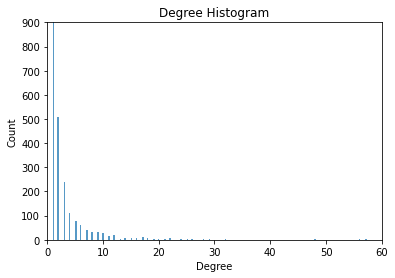

In [15]:
plt.title("Degree Histogram")
plt.ylabel("Count")
plt.xlabel("Degree")
plt.ylim(0, 900)
plt.xlim(0, 60)
plt.hist(x = deg_sorted, bins = 'auto', alpha = 0.75)
fig = plt.gcf()

The following analysis can be made from the histogram

1. The histogram is positively skewed with more than 90% of the data ahveing a degree less than 10
2. Most of the count is for degree of 1 which suggest that a user is mentioning only one another user in their tweets and vice versa.
3. There are a couple of outlier nodes/user with a degree of 147 the user being 'zzeba'.
4. The degree of 147 sugests that most users are mentioning 'zzeba' in their tweets or 'zzeba' is mentioning majority of different users.

###(c)

In [16]:
cnnGraph.edges(data=True)

EdgeDataView([('sxyblkmn', 'mattreeves17', {'numberMentions': 1}), ('sxyblkmn', 'k_may_li', {'numberMentions': 1}), ('sxyblkmn', 'terry_levine', {'numberMentions': 1}), ('sxyblkmn', 'dcb23', {'numberMentions': 2}), ('sxyblkmn', 'phabi', {'numberMentions': 1}), ('sxyblkmn', 'dani', {'numberMentions': 1}), ('sxyblkmn', 'iranriggedelect', {'numberMentions': 1}), ('mattreeves17', 'saharou', {'numberMentions': 1}), ('mattreeves17', 'k_may_li', {'numberMentions': 1}), ('mattreeves17', 'pogoose', {'numberMentions': 1}), ('mattreeves17', 'andrewfynn', {'numberMentions': 1}), ('mattreeves17', 'sambhav6', {'numberMentions': 1}), ('mattreeves17', 'slbbw', {'numberMentions': 1}), ('mattreeves17', 'laura__martin', {'numberMentions': 1}), ('mattreeves17', 'leereed', {'numberMentions': 1}), ('mattreeves17', 'napjeeper', {'numberMentions': 1}), ('mattreeves17', 'ivanlasso', {'numberMentions': 1}), ('mattreeves17', 'poisonthemonkey', {'numberMentions': 1}), ('mattreeves17', 'meloearth', {'numberMention

In [17]:
##https://stackoverflow.com/questions/52440518/finding-maximum-weighted-edge-in-a-networkx-graph-in-python
top_5 = sorted(cnnGraph.edges(data=True),key= lambda x: x[2]['numberMentions'],reverse=True)[0:5]
top_5

[('notalifer', 'keyvan', {'numberMentions': 11}),
 ('cnn', 'alexruff', {'numberMentions': 10}),
 ('wotn', 'iranriggedelect', {'numberMentions': 10}),
 ('iranriggedelect', 'advorec', {'numberMentions': 10}),
 ('laura__martin', 'donlemoncnn', {'numberMentions': 9})]

###(d)

In [0]:
import random
def addRandomPositions(graph):
    posDict = dict((node,(random.gauss(0,10),random.gauss(0,10))) for node in graph.nodes())
    nx.set_node_attributes(graph, name="pos", values=posDict)

In [0]:
addRandomPositions(cnnGraph)

In [20]:
# map purd color scale to 300 cells
purd = cl.scales['9']['seq']['PuRd']
purd300 = cl.interp(purd, 300)
HTML(cl.to_html(purd300))

In [0]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

In [0]:
def plotNetworkSizeColor(graph):
    scatters=[]
    ew=[cnnGraph[node1][node2]['numberMentions'] for (node1, node2) in graph.edges()]

    for (node1, node2) in graph.edges():
        x0, y0 = graph.nodes[node1]['pos']
        x1, y1 = graph.nodes[node2]['pos']
        edgeWidth = graph[node1][node2]['numberMentions']
        edgecolor=int(299*(edgeWidth-min(ew))/(max(ew)-min(ew)))
        s = Scatter(
                x=[x0, x1],
                y=[y0, y1],
                hoverinfo='none',
                mode='lines', 
                line=scatter.Line(width=edgeWidth ,color=purd300[edgecolor]))
        scatters.append(s)


    for node in graph.nodes():
        xPos, yPos = graph.nodes[node]['pos']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                hoverinfo='none',
                mode='markers', 
                marker=dict(
                    color="#888", 
                    size=8,         
                    line=dict(width=2)))
        scatters.append(s)
    
    layout = Layout(showlegend=False, plot_bgcolor='rgba(50,50,0,0)')
    fig = Figure(data=scatters, layout=layout)
    iplot(fig, show_link=False)

In [23]:
configure_plotly_browser_state()
plotNetworkSizeColor(cnnGraph)

###Q3: Content Analysis

###(a)

In [0]:
cnntweets = cnnTag['tweet'].str.cat(sep = ' ')
cnntweets = re.sub(r'[^\w\s]','',cnntweets.lower())
tokenizer = RegexpTokenizer(r'\w+')
cnntokens = tokenizer.tokenize(cnntweets)
stop_words = list(get_stop_words('english'))
nltk_stp = list(stopwords.words('english'))
stop_words.extend(nltk_stp)
stop_words.extend(['http', 'com', 'www', 'rt'])
cnntokens = [word for word in cnntokens if word not in stop_words]
tokencounter = Counter(cnntokens)

In [25]:
tokencounter.most_common(25)

[('cnnfail', 4511),
 ('iranelection', 2950),
 ('iran', 1508),
 ('cnn', 1374),
 ('twitter', 848),
 ('news', 533),
 ('20090614', 437),
 ('election', 378),
 ('tehran', 351),
 ('please', 346),
 ('media', 279),
 ('coverage', 268),
 ('blasts', 259),
 ('bbc', 233),
 ('iranriggedelect', 223),
 ('iranian', 217),
 ('covering', 216),
 ('people', 212),
 ('cover', 208),
 ('networks', 202),
 ('twitterverse', 195),
 ('via', 189),
 ('cnnbrk', 184),
 ('slams', 184),
 ('absence', 183)]

The most common word in the tweet was found to be the hashtag **#cnnfail** itself. Some insights from the top words to the hashtag are as follows.

1. The words like 'iranelection', 'cnn', 'twitter', 'media' etc shows that the general theme was poitics and the media coverage surrounding it during that time.

2. Upon further investigating the tweets it was found that during 14 June 2009, it was the general election in Iran which was covered by multiple news outlets from around the world. The theme shows that people were not happy with the coverage of the election by the media especially cnn was providing of the iran election during that time. People thought that the elctions were rigged by the west.

###(b)

In [0]:
user_words = {}
for user in cnnTag['user']:
  user_tweet = cnnTag[cnnTag['user'] == user]['tweet']
  x = []
  for i in user_tweet:
    x.extend(i.split())
  user_words[user] = Counter(x)

In [27]:
list(dict(user_words['sxyblkmn'].most_common(3)).keys())

['RT', 'on', '#CNNfail']

In [0]:
def plotNetworkSizeColor1(graph):
    scatters=[]
    
    ew=[cnnGraph[node1][node2]['numberMentions'] for (node1, node2) in graph.edges()]

    for (node1, node2) in graph.edges():
        x0, y0 = graph.nodes[node1]['pos']
        x1, y1 = graph.nodes[node2]['pos']
        edgeWidth = graph[node1][node2]['numberMentions']
        edgecolor=int(299*(edgeWidth-min(ew))/(max(ew)-min(ew)))
        s = Scatter(
                x=[x0, x1],
                y=[y0, y1],
                hoverinfo='none',
                mode='lines', 
                line=scatter.Line(width=edgeWidth ,color=purd300[edgecolor]))
        scatters.append(s)


    for node in graph.nodes():
        xPos, yPos = graph.nodes[node]['pos']
        try:
          w = [word for word in list(dict(user_words[node].most_common(3)).keys())]
        except:
          w = ['N','N','N']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                text=" %s , %s" %(w[0],w[1]),
                hoverinfo='text',
                mode='markers', 
                marker=dict(
                    color="#888", 
                    size=nx.degree(graph,node),         
                    line=dict(width=2)))
        scatters.append(s)
    
    layout = Layout(showlegend=False, plot_bgcolor='rgba(50,50,0,0)')
    fig = Figure(data=scatters, layout=layout)
    iplot(fig, show_link=False)

In [46]:
configure_plotly_browser_state()
plotNetworkSizeColor1(cnnGraph)

###Q4: Centrality Analysis

###(a)

The two centrality measures chosen were Betweenness and Pagerank centrality

In [0]:
betweenness_centr = nx.betweenness_centrality(cnnGraph)
pagerank_centr = nx.pagerank(cnnGraph)

In [31]:
betweenness_centr

{'sxyblkmn': 0.0010862663896598083,
 'mattreeves17': 0.005191179906445642,
 'saharou': 4.18162314498238e-06,
 'k_may_li': 0.0002132921043105353,
 'spaley': 0.0,
 'mattreeves17)': 0.0,
 'pogoose': 0.0011558089041474376,
 'andrewfynn': 0.0,
 'sambhav6': 0.00491791345350198,
 'larkin': 0.0,
 'kiyanforoughi': 0.0,
 'slbbw': 0.0003226684272851806,
 'laura__martin': 0.010049336801551715,
 'donlemoncnn': 0.015552323659161297,
 'leereed': 0.0,
 'alonis': 0.0006072500374030821,
 'scobleizer': 0.008307043583671918,
 'iamsharpe': 0.0002265779286717223,
 'trekkerguy': 0.008486934422386728,
 'irannewsnow': 0.04142093577084017,
 'jstrevino': 0.00914909536234654,
 'sowhatquestion': 0.00028804577714792057,
 'cnn': 0.06672854804568135,
 'jranck': 0.012435178140256613,
 'jensenmk': 0.0037775650691478603,
 'acfoltzer': 0.0,
 'brwilliams': 0.0,
 'kylegardiner': 0.0006715336204770496,
 'redinbleustate': 0.007482314495232529,
 'plantwatersun': 0.003567961707948023,
 's3anryan': 0.003186045928879486,
 'joel_

In [32]:
pagerank_centr

{'sxyblkmn': 0.0005422869581327574,
 'mattreeves17': 0.0013841671825322221,
 'saharou': 0.0003235561046289674,
 'k_may_li': 0.00032611132600011023,
 'spaley': 0.0004738122682048826,
 'mattreeves17)': 0.0002561147390943876,
 'pogoose': 0.0006951036348149035,
 'andrewfynn': 0.00012395539362088426,
 'sambhav6': 0.0009102309748476222,
 'larkin': 0.000364963503649635,
 'kiyanforoughi': 0.000364963503649635,
 'slbbw': 0.0005237866568712035,
 'laura__martin': 0.0012955618399170866,
 'donlemoncnn': 0.0023661838854357542,
 'leereed': 0.00012395539362088426,
 'alonis': 0.00028808839842456985,
 'scobleizer': 0.0014586620518986617,
 'iamsharpe': 0.0003047050297629431,
 'trekkerguy': 0.0013502683457842612,
 'irannewsnow': 0.0067183582710887875,
 'jstrevino': 0.0017750938896875393,
 'sowhatquestion': 0.0002654214917173521,
 'cnn': 0.0076514882379750985,
 'jranck': 0.0017821223379468627,
 'jensenmk': 0.000906921069561902,
 'acfoltzer': 0.0001302485713832644,
 'brwilliams': 0.00011781568201007347,
 'k

###(b)

In [0]:
def plotNetworkSizeColor2(graph,clty):
   
    maxCentr = max(clty.values())
    minCentr = min(clty.values())    

    scatters=[]
    for (node1, node2) in graph.edges():
        x0, y0 = graph.nodes[node1]['pos']
        x1, y1 = graph.nodes[node2]['pos']
        edgeWidth = graph[node1][node2]['numberMentions']
        if (clty == betweenness_centr):
          s = Scatter(x=[x0, x1],y=[y0, y1],hoverinfo='none',mode='lines',line=scatter.Line(width=1 ,color='#888'))
        elif (clty == pagerank_centr):
          s = Scatter(x=[x0, x1],y=[y0, y1],hoverinfo='none',mode='lines',line=scatter.Line(width=1 ,color='#999'))

        scatters.append(s)
        
    for node in graph.nodes():
      if (clty == betweenness_centr):
        nodeCentr = clty[node]
        nodeColor = int(299*(nodeCentr-minCentr)/(maxCentr-minCentr))
        xPos, yPos = graph.nodes[node]['pos']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                text="User: %s\n BetnCentrality: %.3f" % (node, nodeCentr),
                hoverinfo='text',
                mode='markers', 
                marker=dict(
                    color=purd300[nodeColor], 
                    size=betweenness_centr[node]*1000,         
                    line=dict(width=2)))
        
      elif (clty == pagerank_centr):
        nodeCentr = clty[node]
        nodeColor = int(299*(nodeCentr-minCentr)/(maxCentr-minCentr))
        xPos, yPos = graph.nodes[node]['pos']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                text="User: %s\n Pagerank: %.3f" % (node, nodeCentr),
                hoverinfo='text',
                mode='markers', 
                marker=dict(
                    color=purd300[nodeColor], 
                    size=pagerank_centr[node]*5000,         
                    line=dict(width=2)))
        
      scatters.append(s)
    
    layout = Layout(showlegend=False,plot_bgcolor='rgba(50,50,50,0)')
    fig = Figure(data=scatters, layout=layout)
    iplot(fig, show_link=False)

In [47]:
configure_plotly_browser_state()
plotNetworkSizeColor2(cnnGraph, betweenness_centr)

In [48]:
configure_plotly_browser_state()
plotNetworkSizeColor2(cnnGraph, pagerank_centr)

###(c)

In [36]:
betn_df = pd.DataFrame(betweenness_centr.items(), columns = ['User','Betweenness Centrality']).sort_values(by = 'Betweenness Centrality', ascending = False)
betn_df.head()

,User,Betweenness Centrality
80,iranriggedelect,0.110718
1308,mashable,0.091303
180,cnnbrk,0.087792
22,cnn,0.066729
647,mahdi,0.066142


In [37]:
pagerank_df = pd.DataFrame(pagerank_centr.items(), columns = ['User','Pagerank Centrality']).sort_values(by = 'Pagerank Centrality', ascending = False)
pagerank_df.head()

,User,Pagerank Centrality
1308,mashable,0.017482
80,iranriggedelect,0.011664
180,cnnbrk,0.008928
22,cnn,0.007651
647,mahdi,0.006956


The key players for both the centrality measures, betweenness and pagerank are shown in the table below.

Centality | User
--- | ---
Betweenness | iranriggedelect, mashable, cnnbrk, cnn, mahdi
Pagerank | mashable, iranriggedelect, cnnbrk, cnn, mahdi


1. The results are different especially for the Page Rank and Betweeness Centrality. In terms of the context of the theme Betweeness Centrality and Degree Centrality gave similar results. The main cause of the difference is that the betweeness centrality detects community while page rank gives weight to the authority. Betweenness centrality of a node v is the sum of the fraction of all-pairs shortest paths that pass through v[https://networkx.github.io/documentation/stable/reference/algorithms/generated/networkx.algorithms.centrality.betweenness_centrality.html#networkx.algorithms.centrality.betweenness_centrality]

2. Betweenness produced more meaningful insight beacuse betweenness centrality detects a community talking about a topic such as 'iranelection' problem in Iran back in 2009. All the key players in this coomunity appreared in top 5. Pagerank wasn't sucessful beacause it dosen't detect community, but ranks the nodes highest authority



###Q5: Connectivity Patterns

###(a)

1. Number of maximal cliques in your graph.

In [0]:
max_cliques = nx.graph_number_of_cliques(cnnGraph)

In [39]:
max_cliques

3453

2. The graph's clique number (size of the largest clique in the graph).

In [0]:
clique_num = nx.graph_clique_number(cnnGraph)

In [41]:
clique_num

5

3. Number of maximal cliques for each node

In [0]:
max_clique_pernode = nx.number_of_cliques(cnnGraph)

In [43]:
max_clique_pernode

{'sxyblkmn': 5,
 'mattreeves17': 13,
 'saharou': 2,
 'k_may_li': 3,
 'spaley': 1,
 'mattreeves17)': 1,
 'pogoose': 6,
 'andrewfynn': 1,
 'sambhav6': 10,
 'larkin': 1,
 'kiyanforoughi': 1,
 'slbbw': 5,
 'laura__martin': 15,
 'donlemoncnn': 26,
 'leereed': 1,
 'alonis': 2,
 'scobleizer': 14,
 'iamsharpe': 3,
 'trekkerguy': 19,
 'irannewsnow': 76,
 'jstrevino': 18,
 'sowhatquestion': 3,
 'cnn': 96,
 'jranck': 17,
 'jensenmk': 7,
 'acfoltzer': 1,
 'brwilliams': 1,
 'kylegardiner': 4,
 'redinbleustate': 33,
 'plantwatersun': 6,
 's3anryan': 5,
 'joel_gehringer': 2,
 'davesusetty': 1,
 'dinameis': 3,
 'robteix': 1,
 'franosch': 30,
 'mjaedin': 1,
 'marjonrostami': 1,
 'nut_cookie': 2,
 'napjeeper': 3,
 'joyomama': 1,
 'dirk2112': 9,
 'icabaru': 1,
 'wotn': 84,
 'mideastyouth': 25,
 'af3': 1,
 'kssouk': 1,
 'seorse': 1,
 'bendeming': 1,
 'ebonystarr55': 6,
 'hopechat': 5,
 '': 32,
 'msnbc': 55,
 'camilo_carreno': 4,
 'richspeer': 1,
 'breakingnews': 7,
 'ap': 1,
 'heyjude408': 6,
 'olivecart'

4. Size of the largest maximal clique containing each given node.

In [0]:
largest_max_clique = nx.node_clique_number(cnnGraph)

In [45]:
largest_max_clique

{'sxyblkmn': 4,
 'mattreeves17': 4,
 'saharou': 4,
 'k_may_li': 3,
 'spaley': 2,
 'mattreeves17)': 2,
 'pogoose': 4,
 'andrewfynn': 2,
 'sambhav6': 4,
 'larkin': 3,
 'kiyanforoughi': 3,
 'slbbw': 4,
 'laura__martin': 4,
 'donlemoncnn': 4,
 'leereed': 2,
 'alonis': 2,
 'scobleizer': 3,
 'iamsharpe': 3,
 'trekkerguy': 4,
 'irannewsnow': 4,
 'jstrevino': 3,
 'sowhatquestion': 2,
 'cnn': 5,
 'jranck': 4,
 'jensenmk': 3,
 'acfoltzer': 2,
 'brwilliams': 2,
 'kylegardiner': 4,
 'redinbleustate': 4,
 'plantwatersun': 4,
 's3anryan': 2,
 'joel_gehringer': 2,
 'davesusetty': 2,
 'dinameis': 3,
 'robteix': 2,
 'franosch': 3,
 'mjaedin': 2,
 'marjonrostami': 2,
 'nut_cookie': 2,
 'napjeeper': 2,
 'joyomama': 2,
 'dirk2112': 2,
 'icabaru': 2,
 'wotn': 4,
 'mideastyouth': 4,
 'af3': 2,
 'kssouk': 2,
 'seorse': 2,
 'bendeming': 2,
 'ebonystarr55': 4,
 'hopechat': 4,
 '': 3,
 'msnbc': 4,
 'camilo_carreno': 4,
 'richspeer': 3,
 'breakingnews': 4,
 'ap': 2,
 'heyjude408': 3,
 'olivecart': 2,
 'nisha_lak

###(b)

The number of maximum cliques was found to be 3453 which mentions about the existence of 3453 sub groups (subsets) in the graph. The size of the largest clique in the graph was found to be 5 which means that 5 users are closely realted to each other where they share information and addition of any other nodes will lead clique being poorly connectivity. Cliques are most useful in detecting a cluster formed by a node in a graph. For example, the chosen hashtag #cnnfail, the clique helps in indentifying about the users posting about a similar topic. It was observed that people were taking about the media and elections in the context of the iran election which will form another clique between users. In this way it helps to root out the users interested in a topic already being talked about.